<a href="https://colab.research.google.com/github/dataforgoodfr/batch7_satellite_ges/blob/master/notebooks/WIP_OCO2_Peaks_Wind_Visualization.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
# !apt-get install libgeos-3.5.0
# !apt-get install libgeos-dev
# !pip install https://github.com/matplotlib/basemap/archive/master.zip

In [0]:
from google.colab import drive
drive.mount('/content/drive')

Go to this URL in a browser: https://accounts.google.com/o/oauth2/auth?client_id=947318989803-6bn6qk8qdgf4n4g3pfee6491hc0brc4i.apps.googleusercontent.com&redirect_uri=urn%3aietf%3awg%3aoauth%3a2.0%3aoob&response_type=code&scope=email%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdocs.test%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive%20https%3a%2f%2fwww.googleapis.com%2fauth%2fdrive.photos.readonly%20https%3a%2f%2fwww.googleapis.com%2fauth%2fpeopleapi.readonly

Enter your authorization code:
··········
Mounted at /content/drive


# OCO2 - Visualize detected peaks and other sources

Project for **Data For Good**, season 7. 

---

## Introduction

Using Data from [OCO-2 Satellite](en.wikipedia.org/wiki/Orbiting_Carbon_Observatory_2), issued by the NASA.

We here try to reproduce the results from [this paper](https://www.atmos-chem-phys-discuss.net/acp-2020-123/) by F. Chevallier, trying to "[observe] carbon dioxide emissions over China's cities with the Orbiting Carbon Observatory-2".

`//TODO: Explanation`

In [0]:
import pandas as pd
import numpy as np
from numpy import exp, loadtxt, pi, sqrt
import matplotlib
import matplotlib.pyplot as plt
import seaborn as sns
# from mpl_toolkits.basemap import Basemap 

/usr/local/lib/python3.6/dist-packages/statsmodels/tools/_testing.py:19: FutureWarning: pandas.util.testing is deprecated. Use the functions in the public API at pandas.testing instead.
  import pandas.util.testing as tm


## Show Data on the map

##### **draw_map**: Function to draw the map and the observations (relief style). The column names can be specified in the arguments.

*Parameters*: 

*   (DataFrame) data: the dataset to map.
*   (string) **x** : the name of the longitude column. *default: 'longitide'*
*   (string) **y**: the name of the latitude column. *default: 'latitude'*
*   (string) **c**: the name of the XCO2 column (or other measure wanted to be plotted). *default: 'xco2'*
*   (int) **lon_min** : the minimum longitude. *default: -180*
*   (int) **lon_max**: the maximum longitude. *default: 180*
*   (int) **lat_min**: the minimum latitude. *default: -90*
*   (int) **lat_max**: the maximum latitude. *default: 90*
*   (int) **size_point**: size of the point to plot (useful if we zoom in). *default: 1*
*   (Bool) **frontier**: whether or not to draw the countries borders. *default: False*



In [0]:
def draw_map(data, x="longitude", y="latitude", c="xco2", lon_min=-180, lon_max=180, lat_min=-90, lat_max=90, size_point=1, frontier=False):

    plt.figure(figsize=(15, 10), edgecolor='w')
    m = Basemap(llcrnrlat=lat_min, urcrnrlat=lat_max, llcrnrlon=lon_min, urcrnrlon=lon_max)
    
    m.shadedrelief()
    
    parallels = np.arange(-80.,81,10.)
    m.drawparallels(parallels,labels=[False,True,True,False])

    meridians = np.arange(10.,351.,20.)
    m.drawmeridians(meridians,labels=[True,False,False,True])

    normal = matplotlib.colors.LogNorm(vmin=data[c].min(), vmax=data[c].max())

    m.scatter(data[x], data[y], c=data[c], cmap=plt.cm.jet, s=size_point, norm=normal)

    if (frontier):
      m.drawcountries(linewidth=0.5)
      m.drawcoastlines(linewidth=0.7)

    plt.show()

##### **haversine**: Function to calculate the great circle distance between two points on the earth given longitude and latitude.

*Parameters*: 

*   (int) **lon1** : the longitude of the first point.
*   (int) **lon2**: the latitude of the first point.
*   (int) **lat1**: the longitude of the second point.
*   (int) **lat2**: the latitude of the second point.

*Return:*


*   (int) the distance (in kilometers)

In [0]:
from math import radians, cos, sin, asin, sqrt

def haversine_formula(lon1, lat1, lon2, lat2):
    # convert decimal degrees to radians 
    lon1, lat1, lon2, lat2 = map(radians, [lon1, lat1, lon2, lat2])

    # haversine formula 
    dlon = lon2 - lon1 
    dlat = lat2 - lat1 
    a = sin(dlat/2)**2 + cos(lat1) * cos(lat2) * sin(dlon/2)**2
    c = 2 * asin(sqrt(a)) 
    r = 6371 # Radius of earth in kilometers. Use 3956 for miles
    return c * r

def haversine(row, lat, lon):
    return haversine_formula(lon, lat, row['longitude'], row['latitude'])

---

## Retieve Data

Sample data can be accessed freely on the NASA Database, among other open data from several NASA sattelites.

We will be using a CSV of peaks detected by *Benoit Courty* [here](https://http://courty.fr/OCO2/).

In [0]:
data = pd.read_csv("https://courty.fr/OCO2/result_for_oco2_1808.csv", sep=",", index_col=0)

data.head()

,sounding_id,latitude,longitude,orbit,slope,intercept,amplitude,sigma,delta,R,windspeed_u,windspeed_v
0,2018080101035604,25.425072,-177.345490,21709,0.000430,404.902899,-14.694226,-3.987167,1.470254,0.677812,-7.759225,-0.739198
1,2018080101062035,33.441360,-179.630508,21709,-0.002734,404.470875,18.128640,3.086571,2.343144,-0.656713,-4.649583,-0.913302
2,2018080101062937,33.919857,-179.779083,21709,-0.006755,404.416030,-11.847855,-3.346435,1.412432,0.592854,-4.035365,-0.879741
3,2018080111005177,37.444622,30.755703,21715,0.006885,404.427158,64.732216,11.112728,2.323860,0.654418,0.284106,-0.315598
4,2018080220003337,44.050335,-106.099586,21735,-0.002019,405.980164,48.714267,14.632683,1.328135,0.528694,1.296467,-3.582739


In [0]:
data.describe()

,sounding_id,latitude,longitude,orbit,slope,intercept,amplitude,sigma,delta,R,windspeed_u,windspeed_v
count,1.900000e+02,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000
mean,2.018082e+15,39.768499,33.659849,21931.678947,-0.000424,402.880780,49.572532,12.542847,1.605843,0.528702,-1.226324,-0.318795
std,9.053339e+08,20.330408,94.924779,132.227826,0.007825,1.955707,34.073177,6.442633,0.780544,0.323260,3.456742,2.767322
min,2.018080e+15,-37.622662,-179.779083,21709.000000,-0.031395,399.106487,-50.333415,-4.286365,1.001662,-0.695312,-8.652188,-7.327242
25%,2.018081e+15,34.444690,-21.849224,21798.000000,-0.006113,401.446896,28.384737,8.804482,1.157435,0.535894,-3.492211,-2.434229
50%,2.018082e+15,38.821541,47.818073,21937.000000,-0.000645,402.978724,43.282624,12.415871,1.352192,0.593488,-1.567396,0.255825
75%,2.018083e+15,50.413721,116.008335,22061.000000,0.004083,404.182765,62.130795,17.120293,1.694740,0.654480,1.107263,1.784825
max,2.018083e+15,72.218102,177.012680,22158.000000,0.024100,408.158002,162.436539,32.880919,5.603435,0.856532,7.725172,9.381126


We spot some negative sigma and amplitude parameters.

In [0]:
data['sigma'] = data['sigma'].apply(abs)
data['amplitude'] = data['amplitude'].apply(abs)
data.head(15)

,sounding_id,latitude,longitude,orbit,slope,intercept,amplitude,sigma,delta,R,windspeed_u,windspeed_v
0,2018080101035604,25.425072,-177.345490,21709,0.000430,404.902899,14.694226,3.987167,1.470254,0.677812,-7.759225,-0.739198
1,2018080101062035,33.441360,-179.630508,21709,-0.002734,404.470875,18.128640,3.086571,2.343144,-0.656713,-4.649583,-0.913302
2,2018080101062937,33.919857,-179.779083,21709,-0.006755,404.416030,11.847855,3.346435,1.412432,0.592854,-4.035365,-0.879741
3,2018080111005177,37.444622,30.755703,21715,0.006885,404.427158,64.732216,11.112728,2.323860,0.654418,0.284106,-0.315598
4,2018080220003337,44.050335,-106.099586,21735,-0.002019,405.980164,48.714267,14.632683,1.328135,0.528694,1.296467,-3.582739
5,2018080400085575,67.064995,177.012680,21752,0.012600,401.988164,91.201144,14.666161,2.480812,0.601865,-1.820583,0.138069
6,2018080400085601,67.107903,176.865494,21752,0.010537,402.054118,104.768724,11.694711,3.573981,0.544848,-1.626402,0.141673
7,2018080400085771,67.189964,176.751221,21752,0.007971,402.105462,128.195493,14.692500,3.480865,0.556012,-1.325972,0.025021
8,2018080400085871,67.238083,176.681656,21752,0.006699,402.059313,142.299708,22.491856,2.523997,0.639850,-1.138405,-0.049650
9,2018080408145507,40.436111,71.393532,21757,0.024100,403.094724,43.217484,16.532307,1.042884,0.811078,3.384520,-1.615621


In [0]:
data.describe()

,sounding_id,latitude,longitude,orbit,slope,intercept,amplitude,sigma,delta,R,windspeed_u,windspeed_v
count,1.900000e+02,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000,190.000000
mean,2.018082e+15,39.768499,33.659849,21931.678947,-0.000424,402.880780,50.691674,12.767373,1.605843,0.528702,-1.226324,-0.318795
std,9.053339e+08,20.330408,94.924779,132.227826,0.007825,1.955707,32.375574,5.982861,0.780544,0.323260,3.456742,2.767322
min,2.018080e+15,-37.622662,-179.779083,21709.000000,-0.031395,399.106487,7.383061,2.027053,1.001662,-0.695312,-8.652188,-7.327242
25%,2.018081e+15,34.444690,-21.849224,21798.000000,-0.006113,401.446896,28.494441,8.804482,1.157435,0.535894,-3.492211,-2.434229
50%,2.018082e+15,38.821541,47.818073,21937.000000,-0.000645,402.978724,43.357822,12.415871,1.352192,0.593488,-1.567396,0.255825
75%,2.018083e+15,50.413721,116.008335,22061.000000,0.004083,404.182765,62.130795,17.120293,1.694740,0.654480,1.107263,1.784825
max,2.018083e+15,72.218102,177.012680,22158.000000,0.024100,408.158002,162.436539,32.880919,5.603435,0.856532,7.725172,9.381126


To convert the  ``` sounding_id ``` into a datetime variable ```date```:



In [0]:
from datetime import datetime
def to_date(a):
    return datetime.strptime(str(a), '%Y%m%d%H%M%S%f')

data['date'] = data['sounding_id'].apply(to_date)
data.head()

,sounding_id,latitude,longitude,orbit,slope,intercept,amplitude,sigma,delta,R,windspeed_u,windspeed_v,date
0,2018080101035604,25.425072,-177.345490,21709,0.000430,404.902899,14.694226,3.987167,1.470254,0.677812,-7.759225,-0.739198,2018-08-01 01:03:56.040
1,2018080101062035,33.441360,-179.630508,21709,-0.002734,404.470875,18.128640,3.086571,2.343144,-0.656713,-4.649583,-0.913302,2018-08-01 01:06:20.350
2,2018080101062937,33.919857,-179.779083,21709,-0.006755,404.416030,11.847855,3.346435,1.412432,0.592854,-4.035365,-0.879741,2018-08-01 01:06:29.370
3,2018080111005177,37.444622,30.755703,21715,0.006885,404.427158,64.732216,11.112728,2.323860,0.654418,0.284106,-0.315598,2018-08-01 11:00:51.770
4,2018080220003337,44.050335,-106.099586,21735,-0.002019,405.980164,48.714267,14.632683,1.328135,0.528694,1.296467,-3.582739,2018-08-02 20:00:33.370


---

## Plot Peaks

### Simple plot (Gaussian)

In [0]:
%matplotlib inline
import scipy.stats as stats

df = data[:5]

for sigma in df['sigma']:

    std = abs(sigma)

    x = np.linspace(-15, 15, 100)
    y = stats.norm.pdf(x,0,std)

    plt.plot(x,y, color='coral')

    plt.grid()

    plt.show()

### Map plot (plotly - UNUSED)

In [0]:
from plotly.figure_factory import create_quiver
import plotly.graph_objects as go
import plotly.express as px

fig = px.scatter_mapbox(data, lat="latitude", lon="longitude", 
                        hover_name="date", hover_data=["amplitude", "sigma"],
                        color_discrete_sequence=["red"], zoom=2, height=700)

fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig.show()
fig.write_html("./peaks.html")

### Map plot (Folium)

In [0]:
import folium

folium_map = folium.Map([43, -100], zoom_start=4,tiles="CartoDB dark_matter")

for index, row in data.iterrows():
    radius = row["amplitude"]/20
    color="#E37222" # tangerine
    tooltip =  "["+str(round(row['latitude'],2))+" ; "+str(round(row['longitude'],2))+"]"
    
    folium.CircleMarker(location=(row["latitude"],
                                  row["longitude"]),
                        radius=radius,
                        color=color,
                        tooltip=tooltip,
                        fill=True).add_to(folium_map)

folium_map.save("peak_map.html")
folium_map

### Map Plot woth Scatter Plots (INCOMPLETE - See Benoit's Website)

In [0]:
!pip install geopandas

In [0]:
import os
import glob
import numpy as np
import pandas as pd

input_dir = 'http://courty.fr/OCO2/'

In [0]:
# http://courty.fr/OCO2/peak_data-f_oco2_1808-o_21733-si_2018080216413233.json

def load_one_peak_data(sounding_id, df_all_peak):
    df_param = df_all_peak.query("sounding_id==@sounding_id")
    param_index = df_param.index[0]
    url = input_dir + "peak_data-f_oco2_1808-o_"+str(df_param.loc[param_index, 'orbit'])+"-si_"+sounding_id+".json"
    print(url)
    df_peak = pd.read_json(url)
    
    gaussian_param = {
        'slope' : df_param.loc[param_index, 'slope'],
        'intercept' : df_param.loc[param_index, 'intercept'],
        'amplitude' : df_param.loc[param_index, 'amplitude'],
        'sigma': df_param.loc[param_index, 'sigma'],
        'delta': df_param.loc[param_index, 'delta'],
        'R' : df_param.loc[param_index, 'R'],
    }
    return df_peak, gaussian_param

'''
x : the data input value
m : the slope of the data
b : the intercep of the data
A : Amplitude de la courbe
sig : sigma / écart type de la courbe
'''
def gaussian(x, m, b, A, sig):
    return m * x + b + A / (sig * (2 * np.pi)**0.5) * np.exp(-x**2 / (2*sig**2))

def plot_peak(df_peak, gaussian_param):
    x = df_peak['distance']
    y = df_peak['xco2']
    y = y - gaussian_param['slope'] * x - gaussian_param['intercept']
    plt.scatter(x, y, c=y, s=3, label='sounding')
    plt.plot(x, gaussian(x, m=0, b=0, A=gaussian_param['amplitude'], sig=gaussian_param['sigma']), 'r', label='fit')
    plt.legend()
    plt.title('OCO 2 data')
    plt.xlabel('Distance')
    plt.ylabel('CO²')
    plt.show()

http://courty.fr/OCO2/peak_data-f_oco2_1808-o_22159-si_2018083122324108.json
{'slope': 0.004776745630485172, 'intercept': 406.0322138728357, 'amplitude': 7.993881983969049, 'sigma': 20.035509511802843, 'delta': 0.15917226891913366, 'R': 0.5012533577553441}


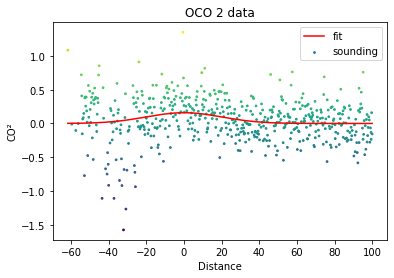

In [0]:
df_res = pd.read_csv(input_dir + "result_for_oco2_1808.csv", sep=",")
df_peak, gaussian_param = load_one_peak_data("2018083122324108", df_res)
print(gaussian_param)
plot_peak(df_peak, gaussian_param)

In [0]:
folium_map = folium.Map([43, -100], zoom_start=4,tiles="CartoDB dark_matter")

for index, row in df_res.iterrows():
    radius = row["amplitude"]/20
    color="#E37222" # tangerine
    tooltip =  "["+str(round(row['latitude'],2))+" ; "+str(round(row['longitude'],2))+"]"
    # popup = folium.Popup(max_width=450).add_child(folium.Vega(peak, width=450, height=250))

    # url = input_dir + "peak_data-f_oco2_1808-o_"+str(int(row['orbit']))+"-si_"+str(int(row['sounding_id']))+".json"
    # print(url)
    # peak = pd.read_json(url)
    
    folium.CircleMarker(location=(row["latitude"],
                                  row["longitude"]),
                        radius=radius,
                        color=color,
                        tooltip=tooltip,
                        # popup=popup,
                        fill=True).add_to(folium_map)

folium_map

### Map plot with wind vectors (INCOMPLETE - Technical Issue)



In [0]:
# Create quiver figure
fig = create_quiver(data.longitude, data.latitude, data.windspeed_u, data.windspeed_v,
                       scale=.25,
                       arrow_scale=.4,
                       name='quiver',
                       line_width=1)

fig.add_trace(go.Scatter(x=data.longitude, y=data.latitude,
                    mode='markers',
                    marker_size=2,
                    name='points'))


fig.update_layout(mapbox_style="open-street-map")
fig.update_layout(margin={"r":0,"t":0,"l":0,"b":0})

fig.show()
fig.write_html("./winds.html")

### Map Plot with EDGAR sources (Too much data => Find another Viz)

In [0]:
path_Edgar_2018 = "/content/drive/My Drive/Data For Good - S7: Ministère & O-CO2/data/edgar/CO2_emissions_Edgar_2018_v3.csv"

edgar = pd.read_csv(path_Edgar_2018, sep=",", index_col=0)

# We only keep the 75% highest registered emitters
edgar_top = edgar[edgar['CO2 classification encoded'] > 2]
edgar_top.describe()

edgar.head()

/usr/local/lib/python3.6/dist-packages/numpy/lib/arraysetops.py:569: FutureWarning:

elementwise comparison failed; returning scalar instead, but in the future will perform elementwise comparison



,latitude,longitude,CO2 emissions,CO2 classification,CO2 classification encoded
0,-89.949997,0.050000,0.0,Low,0
1,-78.349998,-147.949997,0.0,Low,0
2,-78.449997,-147.949997,0.0,Low,0
3,-78.550003,-147.949997,0.0,Low,0
4,-78.650002,-147.949997,0.0,Low,0


In [0]:
# Because there's too much to visualize, we keep only the N highest emissions
N = 1500
count = edgar_top.shape[0]
edgar_top_sample = edgar_top[count-N:count]
edgar_top_sample.describe()

,latitude,longitude,CO2 emissions,CO2 classification encoded
count,1500.000000,1500.000000,1500.000000,1500.0
mean,33.947200,57.953400,0.000003,3.0
std,15.471291,76.752384,0.000005,0.0
min,-38.150002,-151.250000,0.000001,3.0
25%,28.125000,20.200000,0.000002,3.0
50%,35.549999,98.600002,0.000002,3.0
75%,41.250000,116.974998,0.000004,3.0
max,69.349998,152.050003,0.000121,3.0


In [0]:
peaks_with_top_edgar = folium.Map([43, -100], zoom_start=4,tiles="CartoDB dark_matter")

for index, row in data.iterrows():
    radius = row["amplitude"]/20
    color="#E37222" # tangerine
    tooltip =  "["+str(round(row['latitude'],2))+" ; "+str(round(row['longitude'],2))+"]"
    sounding = str(row['sounding_id'])
    date = str(row['date'])
    orbit = str(row['orbit'])
    
    popup_html="""<h4>"""+tooltip+"""</h4>"""+date+"""<p><b>sounding_id:</b> """+sounding+"""</br><b>orbit:</b> """+orbit+"""</p>"""

    popup=folium.Popup(popup_html, max_width=450)
    
    folium.CircleMarker(location=(row["latitude"],
                                  row["longitude"]),
                        radius=radius,
                        color=color,
                        tooltip=tooltip,
                        popup = popup,
                        fill=True).add_to(peaks_with_top_edgar)
    
for index, row in edgar_top_sample.iterrows():
    radius = row['CO2 emissions']*1000
    color="#50C878" # green
    tooltip =  "["+str(round(row['latitude'],2))+" ; "+str(round(row['longitude'],2))+"]"
    emit = str(round(row['CO2 emissions']*1000000,2))

    popup_html="""<h4>"""+tooltip+"""</h4><p><b>CO2 emissions:</b> """+emit+""" (10e-06)</p>"""

    popup=folium.Popup(popup_html, max_width=450)
    
    folium.CircleMarker(location=(row["latitude"],
                                  row["longitude"]),
                        radius=radius,
                        color=color,
                        tooltip=tooltip,
                        popup = popup,
                        fill=True).add_to(peaks_with_top_edgar)
peaks_with_top_edgar.save('peaks_with_top_edgar.html')
peaks_with_top_edgar

### Map plot with Power Plants sources

In [0]:
path_plants = "https://raw.githubusercontent.com/dataforgoodfr/batch7_satellite_ges/master/dataset/CO2_emissions_centrale.csv"

plants = pd.read_csv(path_plants, sep=",", index_col=0)

plants.head()

,country_long,capacity_mw,latitude,longitude,primary_fuel,generation_gwh_2013,generation_gwh_2014,generation_gwh_2015,generation_gwh_2016,generation_gwh_2017,estimated_generation_gwh,gCO2/KWh,generation_gwh_2017_with_estimated_data,tCO2_emitted_in_2013,tCO2_emitted_in_2014,tCO2_emitted_in_2015,tCO2_emitted_in_2016,tCO2_emitted_in_2017,tCO2_emitted_in_2017_with estimated_data
0,Afghanistan,42.0,34.5638,69.1134,Gas,NaN,NaN,NaN,NaN,NaN,NaN,443,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,Algeria,520.0,35.8665,6.0262,Gas,NaN,NaN,NaN,NaN,NaN,2152.249819,443,2152.249819,NaN,NaN,NaN,NaN,NaN,9.534467e+05
2,Algeria,71.0,36.8924,7.7634,Gas,NaN,NaN,NaN,NaN,NaN,293.864879,443,293.864879,NaN,NaN,NaN,NaN,NaN,1.301821e+05
3,Algeria,560.0,36.5988,3.1375,Gas,NaN,NaN,NaN,NaN,NaN,2317.807497,443,2317.807497,NaN,NaN,NaN,NaN,NaN,1.026789e+06
4,Algeria,100.0,36.5914,2.9223,Gas,NaN,NaN,NaN,NaN,NaN,413.894196,443,413.894196,NaN,NaN,NaN,NaN,NaN,1.833551e+05


In [0]:
plants.describe()

,capacity_mw,latitude,longitude,generation_gwh_2013,generation_gwh_2014,generation_gwh_2015,generation_gwh_2016,generation_gwh_2017,estimated_generation_gwh,gCO2/KWh,generation_gwh_2017_with_estimated_data,tCO2_emitted_in_2013,tCO2_emitted_in_2014,tCO2_emitted_in_2015,tCO2_emitted_in_2016,tCO2_emitted_in_2017,tCO2_emitted_in_2017_with estimated_data
count,8602.000000,8602.000000,8602.000000,3078.000000,3117.000000,3312.000000,3274.000000,3210.000000,5403.000000,8602.000000,8440.000000,3.078000e+03,3.117000e+03,3.312000e+03,3.274000e+03,3.210000e+03,8.440000e+03
mean,434.151369,27.287221,-5.885974,1045.620597,1091.104519,1120.312133,1058.376820,1134.772571,2265.492359,700.833062,1842.772024,8.687061e+05,9.019768e+05,9.131356e+05,8.718276e+05,9.289991e+05,1.538757e+06
std,690.388169,24.641181,86.714480,2578.122419,2715.041407,2675.889462,2632.241272,2674.701678,7140.625909,256.469725,5953.860708,2.528086e+06,2.625053e+06,2.607140e+06,2.559000e+06,2.588440e+06,6.046563e+06
min,1.000000,-77.847000,-179.977700,-2.653000,-262.902000,-141.014000,-127.507000,-132.033000,0.000000,443.000000,-132.033000,-1.845416e+03,-2.045378e+05,-6.246920e+04,-5.648560e+04,-5.849062e+04,-5.849062e+04
25%,16.073750,21.434975,-84.425525,0.035250,0.032000,0.025000,0.019000,0.341514,89.494709,443.000000,18.882956,2.567400e+01,2.134832e+01,1.711600e+01,1.287562e+01,2.172565e+02,1.086195e+04
50%,132.250000,35.594300,-23.547500,18.245000,16.227000,22.749000,16.377500,36.623000,737.318085,778.000000,340.484944,8.859949e+03,8.021180e+03,1.098873e+04,8.077698e+03,1.881502e+04,2.080822e+05
75%,600.000000,42.104150,79.832125,633.405479,630.858000,762.341497,583.308501,697.294500,2782.119122,1050.000000,2240.154958,3.416080e+05,3.368590e+05,4.247199e+05,3.279560e+05,3.801258e+05,1.423369e+06
max,8865.000000,71.292000,178.835900,27586.200000,28127.000000,32157.000000,30015.000000,35116.000000,450562.692350,1050.000000,450562.692350,2.896551e+07,2.953335e+07,3.376485e+07,3.151575e+07,3.687180e+07,4.730908e+08


In [0]:
peaks_and_plants_dark = folium.Map([43, 0], zoom_start=4,tiles="CartoDB dark_matter")

for index, row in data.iterrows():
    radius = row["amplitude"]/20
    color="#E37222" # tangerine
    tooltip =  "["+str(round(row['latitude'],2))+" ; "+str(round(row['longitude'],2))+"]"
    sounding = str(row['sounding_id'])
    date = str(row['date'])
    orbit = str(row['orbit'])
    
    popup_html="""<h4>"""+tooltip+"""</h4>"""+date+"""<p>sounding_id: """+sounding+"""</br>orbit: """+orbit+"""</p>"""

    popup=folium.Popup(popup_html, max_width=450)
    
    folium.CircleMarker(location=(row["latitude"],
                                  row["longitude"]),
                        radius=radius,
                        color=color,
                        tooltip=tooltip,
                        popup=popup,
                        fill=True).add_to(peaks_and_plants_dark)

for index, row in plants.iterrows():
    radius = 0.1
    color="#3186CC" # blue
    tooltip =  "["+str(round(row['latitude'],2))+" ; "+str(round(row['longitude'],2))+"]"
    emit = str(round(row['estimated_generation_gwh'],2))
    popup_html="""<h4>"""+tooltip+"""</h4>"""+row['country_long']+"""<p>Emission 2018 (est): """+emit+""" GWh</p>"""

    popup=folium.Popup(popup_html, max_width=450)

    folium.CircleMarker(location=(row["latitude"],
                                  row["longitude"]),
                        radius=radius,
                        color=color,
                        tooltip=tooltip,
                        popup=popup,
                        fill=True).add_to(peaks_and_plants_dark)

peaks_and_plants_dark.save('peaks_and_plants.html')
peaks_and_plants_dark

### Map plot with Cities estimates

In [0]:
path_cities = "/content/drive/My Drive/Data For Good - S7: Ministère & O-CO2/data/others/worldcities.csv"

cities = pd.read_csv(path_cities, sep=",", index_col=0)

cities.head()

,city_ascii,lat,lng,country,iso2,iso3,admin_name,capital,population,id
city,,,,,,,,,,
Tokyo,Tokyo,35.6850,139.7514,Japan,JP,JPN,Tōkyō,primary,35676000.0,1392685764
New York,New York,40.6943,-73.9249,United States,US,USA,New York,NaN,19354922.0,1840034016
Mexico City,Mexico City,19.4424,-99.1310,Mexico,MX,MEX,Ciudad de México,primary,19028000.0,1484247881
Mumbai,Mumbai,19.0170,72.8570,India,IN,IND,Mahārāshtra,admin,18978000.0,1356226629
São Paulo,Sao Paulo,-23.5587,-46.6250,Brazil,BR,BRA,São Paulo,admin,18845000.0,1076532519


In [0]:
cities.describe()

,lat,lng,population,id
count,15493.000000,15493.000000,1.380800e+04,1.549300e+04
mean,29.633315,-29.834189,1.812480e+05,1.623208e+09
std,22.414727,76.340457,7.947989e+05,2.826451e+08
min,-54.933300,-179.590000,0.000000e+00,1.004003e+09
25%,22.305000,-86.324200,9.167500e+03,1.404601e+09
50%,37.756200,-71.916700,2.349650e+04,1.826644e+09
75%,42.444200,25.582100,9.030625e+04,1.840015e+09
max,82.483300,179.383300,3.567600e+07,1.934000e+09


In [0]:
# Because there's too much to visualize, we keep only the most populated cities (500.000+ hab)
cities_top = cities[cities["population"] > 500000]
cities_top.describe()

,lat,lng,population,id
count,974.000000,974.000000,9.740000e+02,9.740000e+02
mean,25.378404,37.178068,1.787844e+06,1.413759e+09
std,20.902779,75.392899,2.465071e+06,2.598021e+08
min,-38.000000,-157.846000,5.005770e+05,1.004003e+09
25%,15.338650,-3.223525,7.297780e+05,1.156547e+09
50%,30.710000,45.000000,1.014000e+06,1.360893e+09
75%,39.260600,108.849925,1.749000e+06,1.643157e+09
max,60.175600,174.763000,3.567600e+07,1.894157e+09


In [0]:
cities_top['city_ascii'].head(150)

city
Tokyo                Tokyo
New York          New York
Mexico City    Mexico City
Mumbai              Mumbai
São Paulo        Sao Paulo
                  ...     
Taichung          Taichung
Brooklyn          Brooklyn
Ibadan              Ibadan
Faisalabad      Faisalabad
Fuzhou              Fuzhou
Name: city_ascii, Length: 150, dtype: object

In [0]:
peaks_and_cities = folium.Map([43, 0], zoom_start=4,tiles="CartoDB dark_matter")

for index, row in data.iterrows():
    radius = row["amplitude"]/20
    color="#E37222" # tangerine
    tooltip =  "["+str(round(row['latitude'],2))+" ; "+str(round(row['longitude'],2))+"]"
    sounding = str(row['sounding_id'])
    date = str(row['date'])
    orbit = str(row['orbit'])
    
    popup_html="""<h4>"""+tooltip+"""</h4>"""+date+"""<p>sounding_id: """+sounding+"""</br>orbit: """+orbit+"""</p>"""

    popup=folium.Popup(popup_html, max_width=450)
    
    folium.CircleMarker(location=(row["latitude"],
                                  row["longitude"]),
                        radius=radius,
                        color=color,
                        tooltip=tooltip,
                        popup=popup,
                        fill=True).add_to(peaks_and_cities)

for index, row in cities_top.iterrows():
    radius = row['population']/2000000
    color="#FEF65B" # yellow
    tooltip =  "["+str(round(row['lat'],2))+" ; "+str(round(row['lng'],2))+"]"
    pop = str(round(row['population'],0))
    title = "" + index + ", " + str(row['country'])
    # popup_html="""<h4><b>"""+row["city_ascii"]+"""</b>, """+row["country"]+"""</h4>"""+"""<p>"""+tooltip+"""</p>"""+"""<p>Population 2017: """+pop+"""</p>"""

    popup_html = """<h4>"""+title+"""</h4><p>"""+tooltip+"""</p>"""+"""<p><b>Population 2017:</b> """+pop+"""</p>"""

    popup=folium.Popup(popup_html, max_width=450)

    folium.CircleMarker(location=(row["lat"],
                                  row["lng"]),
                        radius=radius,
                        color=color,
                        tooltip=tooltip,
                        popup=popup,
                        fill=True).add_to(peaks_and_cities)
                        
peaks_and_cities.save('peaks_and_cities.html')
peaks_and_cities

## Merging plots (Peaks + EDGAR + Plants + Cities)

In [0]:
# Initialize Map
peaks_and_sources = folium.Map([43, 0], zoom_start=4)
folium.TileLayer("CartoDB dark_matter", name="Dark mode").add_to(peaks_and_sources)

# Adding detected peaks
peaks_group = folium.FeatureGroup(name="Peaks").add_to(peaks_and_sources)
for index, row in data.iterrows():
    radius = row["amplitude"]/20
    color="#FF3333" # tangeredrine
    tooltip =  "["+str(round(row['latitude'],2))+" ; "+str(round(row['longitude'],2))+"]"
    sounding = str(row['sounding_id'])
    date = str(row['date'])
    orbit = str(row['orbit'])
    
    popup_html="""<h4>"""+tooltip+"""</h4>"""+date+"""<p>sounding_id: """+sounding+"""</br>orbit: """+orbit+"""</p>"""

    popup=folium.Popup(popup_html, max_width=450)
    
    peaks_group.add_child(folium.CircleMarker(location=(row["latitude"],
                                  row["longitude"]),
                        radius=radius,
                        color=color,
                        tooltip=tooltip,
                        popup=popup,
                        fill=True))


# Adding EDGAR top
edgar_group = folium.FeatureGroup(name="Edgar").add_to(peaks_and_sources)
for index, row in edgar_top_sample.iterrows():
    radius = row['CO2 emissions']*1000000
    color="#50C878" # green
    tooltip =  "["+str(round(row['latitude'],2))+" ; "+str(round(row['longitude'],2))+"]"
    emit = str(round(row['CO2 emissions']*1000000,2))

    popup_html="""<h4>"""+tooltip+"""</h4><p><b>CO2 emissions:</b> """+emit+""" (10e-06)</p>"""

    popup=folium.Popup(popup_html, max_width=450)
    
    edgar_group.add_child(folium.CircleMarker(location=(row["latitude"],
                                  row["longitude"]),
                        radius=radius,
                        color=color,
                        tooltip=tooltip,
                        popup = popup,
                        fill=True))


# Adding Power plants
plants_group = folium.FeatureGroup(name="Plants").add_to(peaks_and_sources)
for index, row in plants.iterrows():
    radius = row['estimated_generation_gwh']/10000
    color="#3186CC" # blue
    tooltip =  "["+str(round(row['latitude'],2))+" ; "+str(round(row['longitude'],2))+"]"
    emit = str(round(row['estimated_generation_gwh'],2))
    popup_html="""<h4>"""+tooltip+"""</h4>"""+row['country_long']+"""<p><b>Emission 2018 (est):</b> """+emit+""" GWh</p>"""

    popup=folium.Popup(popup_html, max_width=450)

    plants_group.add_child(folium.CircleMarker(location=(row["latitude"],
                                  row["longitude"]),
                        radius=radius,
                        color=color,
                        tooltip=tooltip,
                        popup=popup,
                        fill=True))


# Adding Cities
cities_group = folium.FeatureGroup(name="Cities").add_to(peaks_and_sources)
for index, row in cities_top.iterrows():
    radius = row['population']/2000000
    color="#FEF65B" # yellow
    tooltip =  "["+str(round(row['lat'],2))+" ; "+str(round(row['lng'],2))+"]"
    pop = str(int(row['population']))
    title = "" + index + ", " + str(row['country'])
    # popup_html="""<h4><b>"""+row["city_ascii"]+"""</b>, """+row["country"]+"""</h4>"""+"""<p>"""+tooltip+"""</p>"""+"""<p>Population 2017: """+pop+"""</p>"""

    popup_html = """<h4>"""+title+"""</h4><p>"""+tooltip+"""</p>"""+"""<p><b>Population 2017:</b> """+pop+"""</p>"""

    popup=folium.Popup(popup_html, max_width=450)

    cities_group.add_child(folium.CircleMarker(location=(row["lat"],
                                  row["lng"]),
                        radius=radius,
                        color=color,
                        tooltip=tooltip,
                        popup=popup,
                        fill=True))


folium.map.LayerControl(collapsed=False).add_to(peaks_and_sources)
peaks_and_sources.save("peaks_and_sources.html")
peaks_and_sources